In [41]:
import pandas as pd
import numpy as np

In [2]:
df = pd.read_csv("car data.csv")

In [3]:
df.head()

,Car_Name,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner
0,ritz,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0


In [4]:
df.shape

(301, 9)

In [5]:
print(df["Fuel_Type"].unique())
print(df["Seller_Type"].unique())
print(df["Transmission"].unique())
print(df["Owner"].unique())

['Petrol' 'Diesel' 'CNG']
['Dealer' 'Individual']
['Manual' 'Automatic']
[0 1 3]


In [6]:
# check missing or null values
df.isnull().sum()

Car_Name         0
Year             0
Selling_Price    0
Present_Price    0
Kms_Driven       0
Fuel_Type        0
Seller_Type      0
Transmission     0
Owner            0
dtype: int64

In [7]:
df.describe()

,Year,Selling_Price,Present_Price,Kms_Driven,Owner
count,301.000000,301.000000,301.000000,301.000000,301.000000
mean,2013.627907,4.661296,7.628472,36947.205980,0.043189
std,2.891554,5.082812,8.644115,38886.883882,0.247915
min,2003.000000,0.100000,0.320000,500.000000,0.000000
25%,2012.000000,0.900000,1.200000,15000.000000,0.000000
50%,2014.000000,3.600000,6.400000,32000.000000,0.000000
75%,2016.000000,6.000000,9.900000,48767.000000,0.000000
max,2018.000000,35.000000,92.600000,500000.000000,3.000000


In [8]:
df.columns

Index(['Car_Name', 'Year', 'Selling_Price', 'Present_Price', 'Kms_Driven',
       'Fuel_Type', 'Seller_Type', 'Transmission', 'Owner'],
      dtype='object')

In [9]:
data = df.drop("Car_Name",axis = 1)

In [10]:
data.head()

,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner
0,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0
1,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0
2,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0
3,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0
4,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0


In [11]:
# Creating new feature
data['Current_Year'] = 2020

In [12]:
data.head()

,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner,Current_Year
0,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0,2020
1,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0,2020
2,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0,2020
3,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0,2020
4,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0,2020


In [13]:
data['No_of_Years'] = data["Current_Year"] - data["Year"]

In [14]:
data.head()

,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner,Current_Year,No_of_Years
0,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0,2020,6
1,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0,2020,7
2,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0,2020,3
3,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0,2020,9
4,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0,2020,6


In [15]:
data.drop(["Year","Current_Year"],axis =1, inplace = True)

In [16]:
data.head()

,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner,No_of_Years
0,3.35,5.59,27000,Petrol,Dealer,Manual,0,6
1,4.75,9.54,43000,Diesel,Dealer,Manual,0,7
2,7.25,9.85,6900,Petrol,Dealer,Manual,0,3
3,2.85,4.15,5200,Petrol,Dealer,Manual,0,9
4,4.60,6.87,42450,Diesel,Dealer,Manual,0,6


In [17]:
# For categorical features we use dummy() function
data = pd.get_dummies(data,drop_first = True)

In [18]:
data.head()

,Selling_Price,Present_Price,Kms_Driven,Owner,No_of_Years,Fuel_Type_Diesel,Fuel_Type_Petrol,Seller_Type_Individual,Transmission_Manual
0,3.35,5.59,27000,0,6,0,1,0,1
1,4.75,9.54,43000,0,7,1,0,0,1
2,7.25,9.85,6900,0,3,0,1,0,1
3,2.85,4.15,5200,0,9,0,1,0,1
4,4.60,6.87,42450,0,6,1,0,0,1


In [19]:
data.corr()

,Selling_Price,Present_Price,Kms_Driven,Owner,No_of_Years,Fuel_Type_Diesel,Fuel_Type_Petrol,Seller_Type_Individual,Transmission_Manual
Selling_Price,1.000000,0.878983,0.029187,-0.088344,-0.236141,0.552339,-0.540571,-0.550724,-0.367128
Present_Price,0.878983,1.000000,0.203647,0.008057,0.047584,0.473306,-0.465244,-0.512030,-0.348715
Kms_Driven,0.029187,0.203647,1.000000,0.089216,0.524342,0.172515,-0.172874,-0.101419,-0.162510
Owner,-0.088344,0.008057,0.089216,1.000000,0.182104,-0.053469,0.055687,0.124269,-0.050316
No_of_Years,-0.236141,0.047584,0.524342,0.182104,1.000000,-0.064315,0.059959,0.039896,-0.000394
Fuel_Type_Diesel,0.552339,0.473306,0.172515,-0.053469,-0.064315,1.000000,-0.979648,-0.350467,-0.098643
Fuel_Type_Petrol,-0.540571,-0.465244,-0.172874,0.055687,0.059959,-0.979648,1.000000,0.358321,0.091013
Seller_Type_Individual,-0.550724,-0.512030,-0.101419,0.124269,0.039896,-0.350467,0.358321,1.000000,0.063240
Transmission_Manual,-0.367128,-0.348715,-0.162510,-0.050316,-0.000394,-0.098643,0.091013,0.063240,1.000000


In [20]:
import seaborn as sns

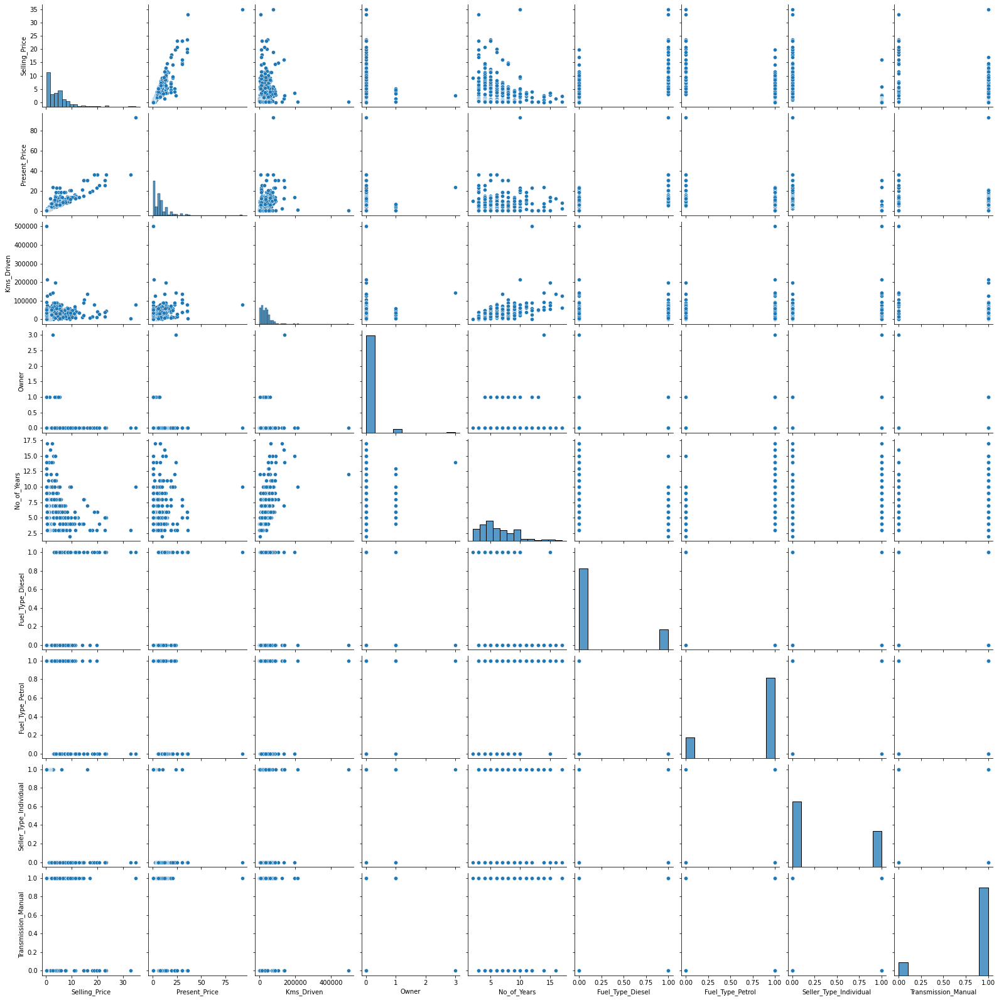

In [21]:
sns.pairplot(data)

In [22]:
# sns.heatmap(data.corr(),annot = True)
import matplotlib.pyplot as plt
%matplotlib inline

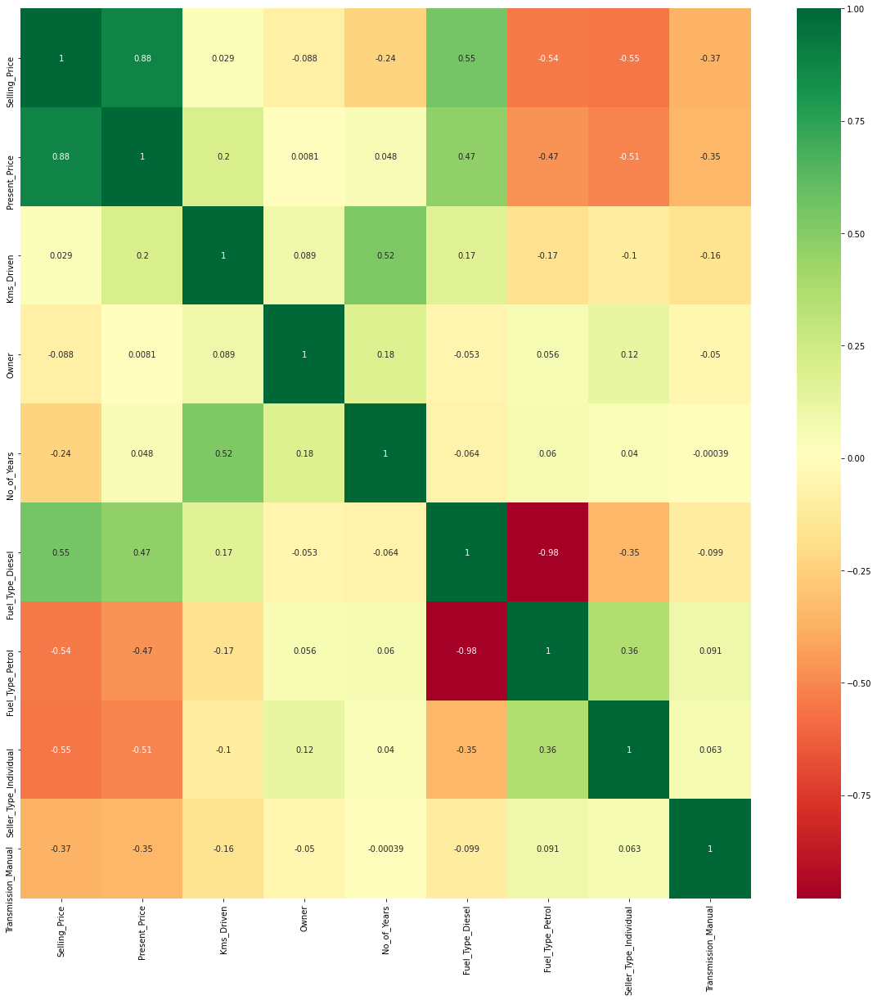

In [23]:
data_corr = data.corr()
top_corr_features = data_corr.index
plt.figure(figsize = (20,20))

# plot heatmap
g = sns.heatmap(data[top_corr_features].corr(), annot = True, cmap = "RdYlGn")

In [24]:
# independent and dependent features
x = data.drop("Selling_Price",axis = 1)     # data.iloc[:,1:]
y = data["Selling_Price"]  # data.iloc[:,0]

In [25]:
x.head()

,Present_Price,Kms_Driven,Owner,No_of_Years,Fuel_Type_Diesel,Fuel_Type_Petrol,Seller_Type_Individual,Transmission_Manual
0,5.59,27000,0,6,0,1,0,1
1,9.54,43000,0,7,1,0,0,1
2,9.85,6900,0,3,0,1,0,1
3,4.15,5200,0,9,0,1,0,1
4,6.87,42450,0,6,1,0,0,1


In [26]:
y.head()

0    3.35
1    4.75
2    7.25
3    2.85
4    4.60
Name: Selling_Price, dtype: float64

In [31]:
## Feature Importance
from sklearn.ensemble import ExtraTreesRegressor
model = ExtraTreesRegressor()
model.fit(x,y)

ExtraTreesRegressor()

In [32]:
print(model.feature_importances_)

[0.38772132 0.04249486 0.00048626 0.07387265 0.2183546  0.01668903
 0.11761413 0.14276716]


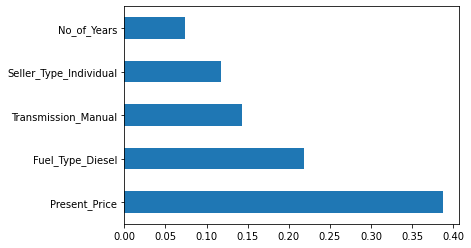

In [34]:
# ploty graph of feature importances for better visualizations
feat_importances = pd.Series(model.feature_importances_,index= x.columns)
feat_importances.nlargest(5).plot(kind="barh")
plt.show()

In [35]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2)

In [39]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(240, 8)
(61, 8)
(240,)
(61,)


In [40]:
from sklearn.ensemble import RandomForestRegressor
rf_random = RandomForestRegressor()

In [44]:
## Hyperparameters for Randomized Search CV

n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1200, num = 12)]
n_estimators

[100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200]

In [45]:
# Number of trees in Random Forest
n_estimators
# Number of features to consider at every split
max_features = ["auto","sqrt"]
# Max number of levels in tree
max_depth = [int(x) for x in np.linspace(5, 30, num = 6)]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10, 15, 100]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 5, 10]

In [47]:
from sklearn.model_selection import RandomizedSearchCV

# Create the random grid
random_grid = {'n_estimators' : n_estimators,
               'max_features' : max_features,
               'max_depth' : max_depth,
               'min_samples_split' : min_samples_split,
               'min_samples_leaf' : min_samples_leaf
}
print(random_grid)

{'n_estimators': [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 1100, 1200], 'max_features': ['auto', 'sqrt'], 'max_depth': [5, 10, 15, 20, 25, 30], 'min_samples_split': [2, 5, 10, 15, 100], 'min_samples_leaf': [1, 2, 5, 10]}


In [48]:
# Use the random grid to search for best parameters
# create instance of model
rf = RandomForestRegressor()

In [49]:
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, scoring = "neg_mean_squared_error", n_iter = 10, cv = 5, verbose = 2, random_state = 42, n_jobs = 1)

In [50]:
rf_random.fit(x_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   1.5s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   1.5s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   1.4s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   1.4s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   1.4s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=1100; total time=   1.9s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=1100; total time=   1.8s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimator

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=1,
                   param_distributions={'max_depth': [5, 10, 15, 20, 25, 30],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15,
                                                              100],
                                        'n_estimators': [100, 200, 300, 400,
                                                         500, 600, 700, 800,
                                                         900, 1000, 1100,
                                                         1200]},
                   random_state=42, scoring='neg_mean_squared_error',
                   verbose=2)

In [51]:
predictions = rf_random.predict(x_test)

In [52]:
predictions

array([ 7.51207,  8.00167,  4.07153,  8.1143 , 12.11282,  0.95709,
        1.36182,  1.12929,  0.95424,  6.24616,  6.80868,  0.33288,
        3.44667,  0.57024,  0.58202,  4.22956,  1.06575,  4.52365,
        2.2287 ,  5.27816,  5.51785, 20.72238,  5.2871 ,  1.11329,
        9.32518,  2.85308,  4.10421,  6.80556,  4.87998,  6.92895,
        4.4486 ,  0.61843,  8.53044,  9.02841,  0.67529,  0.89337,
        5.80055,  9.78533,  5.4158 ,  3.44586,  0.58667,  8.07579,
        4.57776,  7.53751,  3.65923,  5.54177,  5.52035,  1.46732,
        4.13346, 10.98535,  2.62531, 11.20685,  4.43351,  8.2487 ,
        6.66121,  1.02695,  0.21981,  8.01785,  4.56622,  3.08641,
        5.09955])

<AxesSubplot:xlabel='Selling_Price', ylabel='Count'>

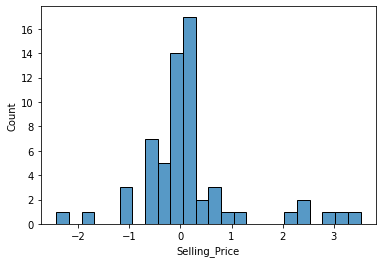

In [55]:
sns.distplot(y_test-predictions)

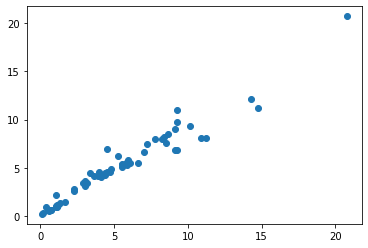

In [54]:
plt.scatter(y_test, predictions)

In [56]:
import pickle
# open the file where you want to store the data
file = open("random_forest_regression_model.pkl","wb")

# dump information to that file
pickle.dump(rf_random, file)

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "D:\Mayura\Python\envs\carprediction\lib\asyncio\selector_events.py", line 119, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] 